In [ ]:
!pip install librosa

In [ ]:
import os
import librosa
import numpy as np
import librosa.display
import soundfile as sf
import matplotlib.pyplot as plt
from IPython.display import display, Audio

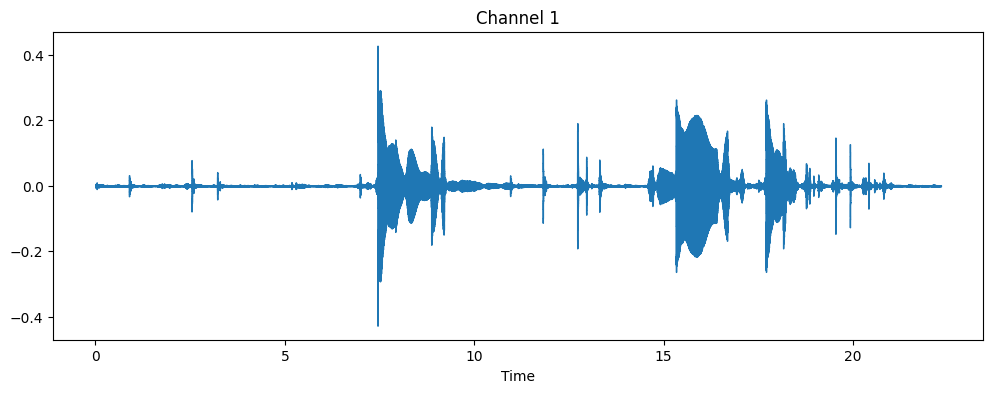

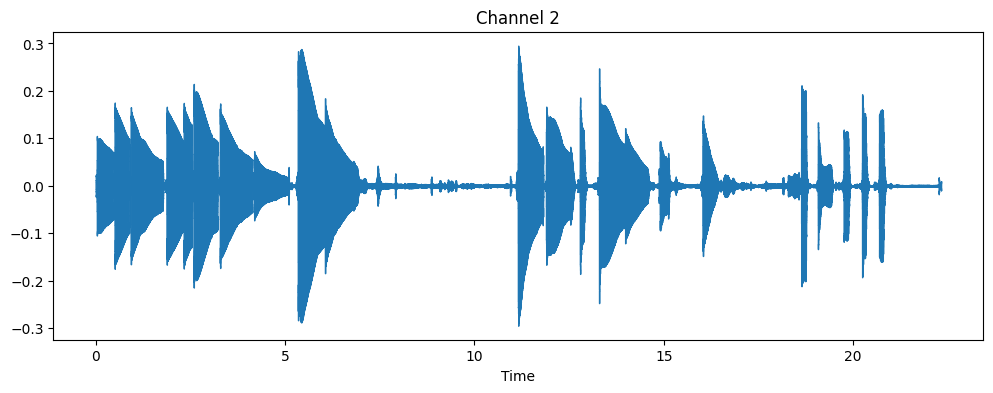

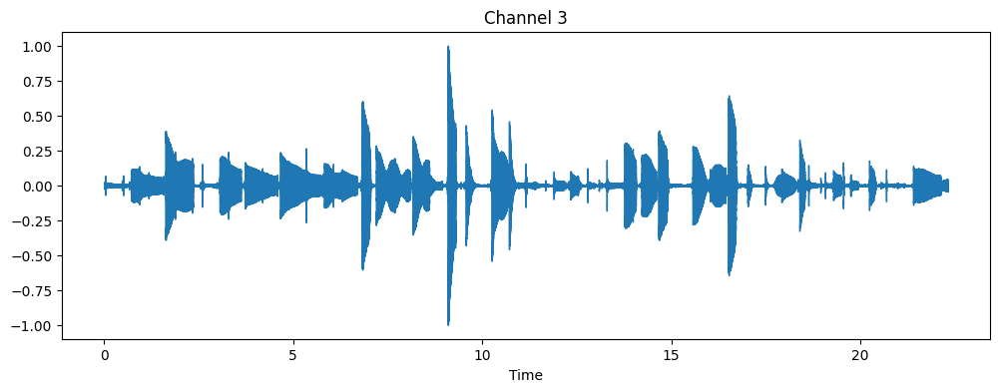

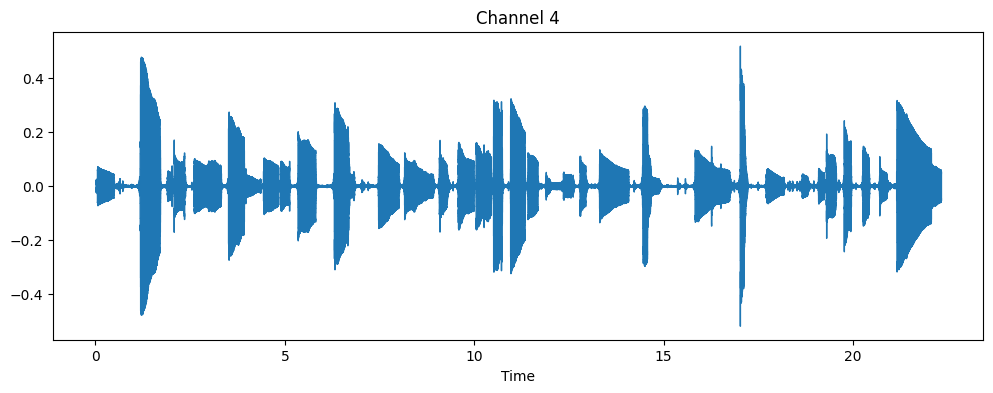

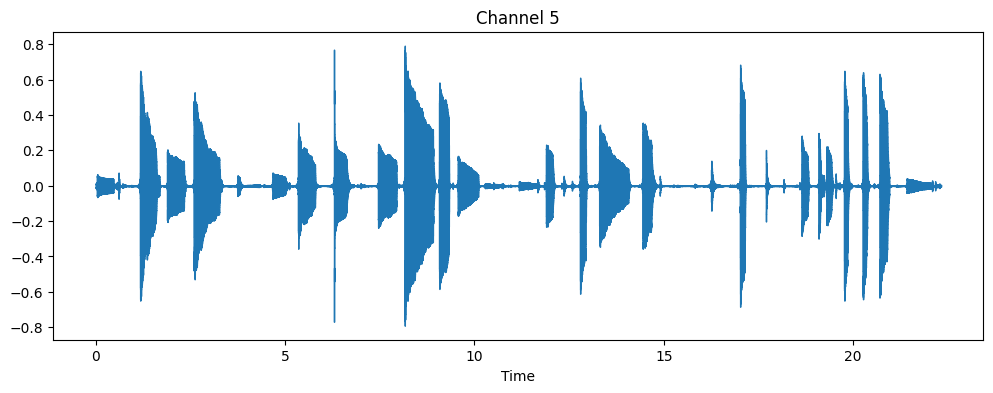

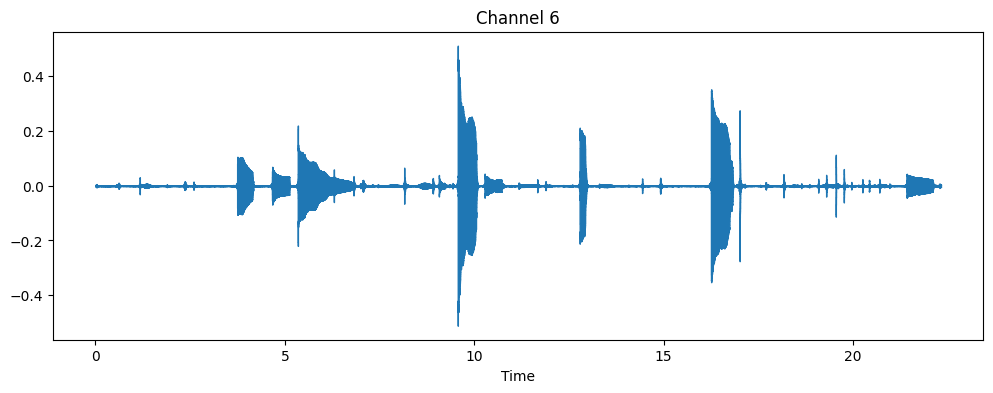

In [ ]:
# Load the audio file
y, sr = librosa.load('00_BN1-129-Eb_comp.wav', sr=None, mono=False)

# Plot each channel separately
for i in range(y.shape[0]):
    plt.figure(figsize=(12, 4))
    librosa.display.waveshow(y[i], sr=sr)
    plt.title(f'Channel {i+1}')
    plt.show()

<ipython-input-9-6ef6c0ac17e0>:3: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  D = librosa.amplitude_to_db(librosa.stft(y[i]), ref=np.max)


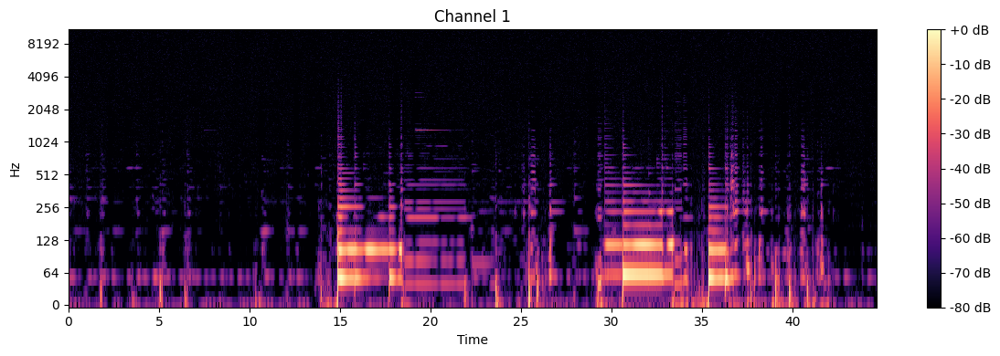

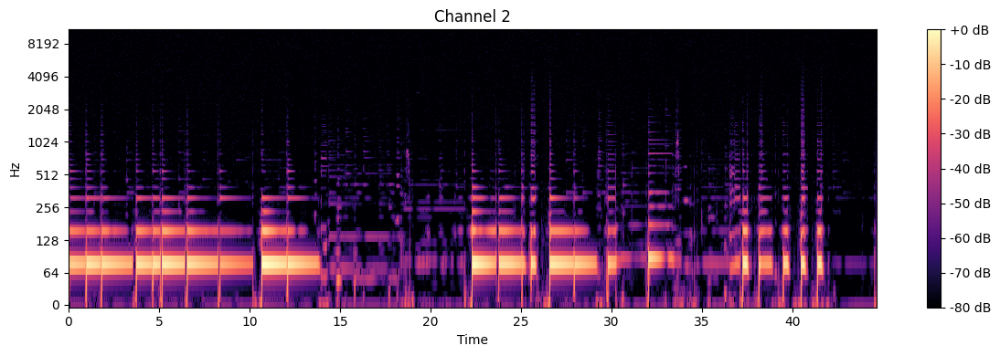

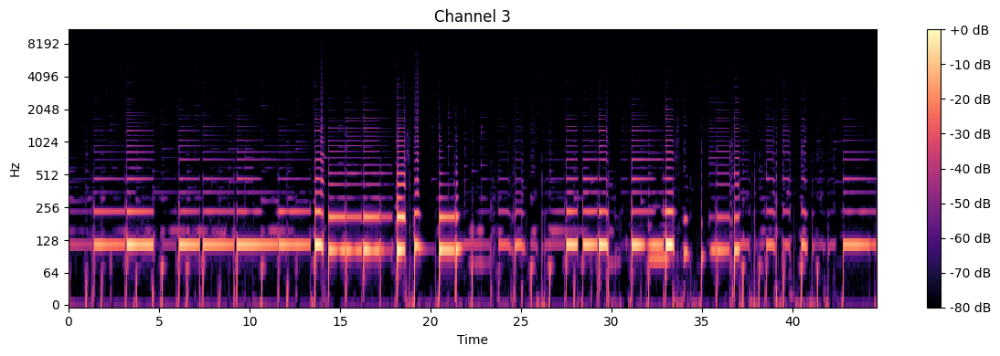

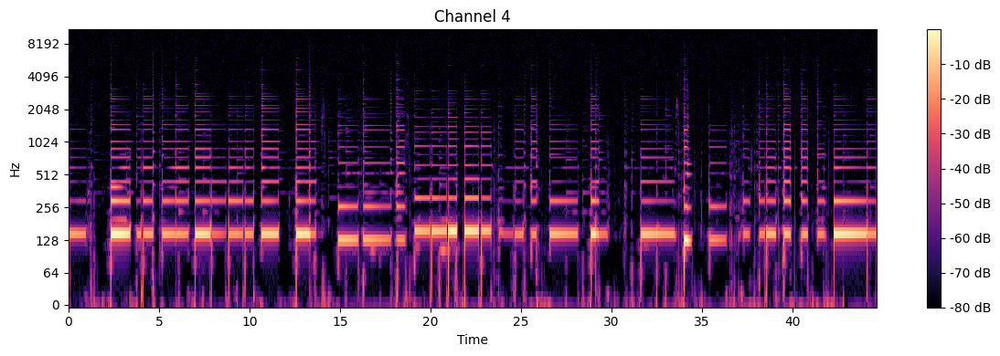

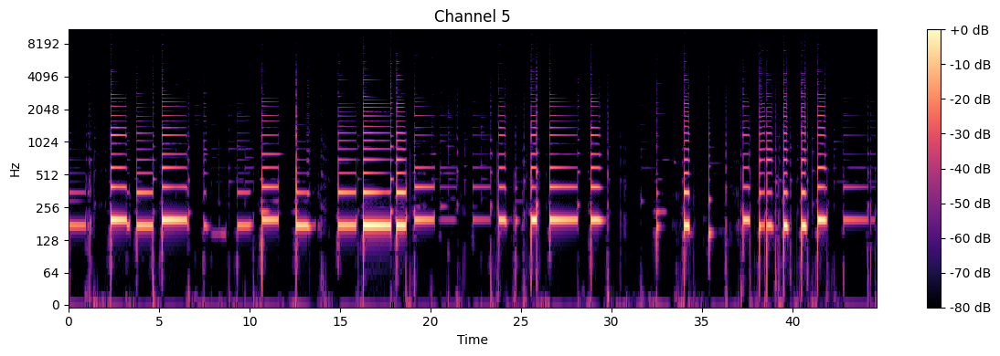

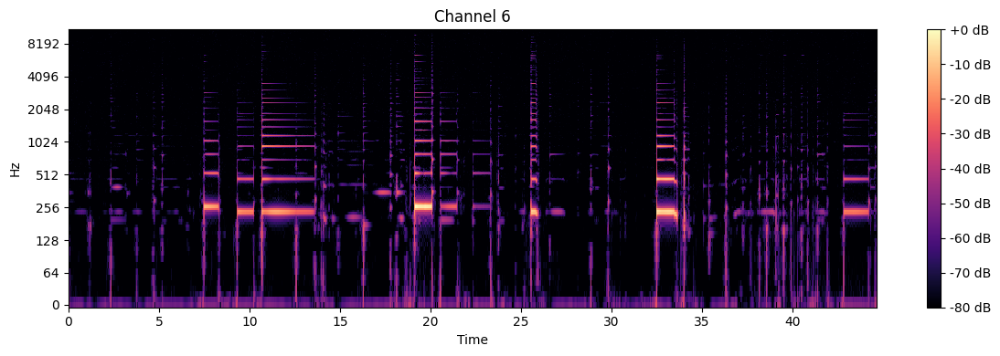

In [ ]:
for i in range(y.shape[0]):
    plt.figure(figsize=(12, 4))
    D = librosa.amplitude_to_db(librosa.stft(y[i]), ref=np.max)
    librosa.display.specshow(D, y_axis='log', x_axis='time')
    plt.title(f'Channel {i+1}')
    plt.colorbar(format='%+2.0f dB')
    plt.tight_layout()
    plt.show()

In [ ]:
def augment_audio_advanced(y, sr, augment_type, alpha):

    if augment_type == 'time_stretching':
        # Harmonic-Percussive separation
        y_harmonic, y_percussive = librosa.effects.hpss(y)

        # Stretching the components separately
        rate = np.random.uniform(0.9, 1.1)  # Random stretching between 90% and 110%
        y_harmonic_stretched = librosa.effects.time_stretch(y_harmonic, rate=rate)
        y_percussive_stretched = librosa.effects.time_stretch(y_percussive, rate=rate)

        # Combine them again
        y_stretched = y_harmonic_stretched + y_percussive_stretched
        return y_stretched

    if augment_type == 'pitch_shifting':
        # Pitch shifting
        steps = np.random.randint(-2, 2)  # Random shift between -2 and 2 semitones
        y_shifted = librosa.effects.pitch_shift(y, sr=sr, n_steps=steps)

        # Introducing inharmonicity by shifting the harmonic part a bit more
        y_harmonic, _ = librosa.effects.hpss(y_shifted)
        y_inharmonic = y_shifted + 0.0125 * librosa.effects.pitch_shift(y_harmonic, sr=sr, n_steps=steps)
        return y_inharmonic

    if augment_type == 'noise_injection':
        noise = np.random.randn(*y.shape)
        signal_power = np.sum(y**2)
        noise_power = np.sum(noise**2)
        ratio = signal_power / noise_power
        noisy = y + alpha * np.sqrt(ratio) * noise
        return noisy

In [ ]:
# Perform data augmentation
y_augmented_ts = augment_audio_advanced(y, sr, augment_type='time_stretching', alpha=0.1)
y_augmented_ni = augment_audio_advanced(y, sr, augment_type='noise_injection', alpha=0.1)
y_augmented_ps = augment_audio_advanced(y, sr, augment_type='pitch_shifting', alpha=0.1)

# Save the augmented audio file
sf.write('BN1_TS.wav', y_augmented_ts.T, sr)
sf.write('BN1_NI.wav', y_augmented_ni.T, sr)
sf.write('BN1_PS.wav', y_augmented_ps.T, sr)

<ipython-input-19-9872691807a4>:4: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  D = librosa.amplitude_to_db(librosa.stft(y[i]), ref=np.max)


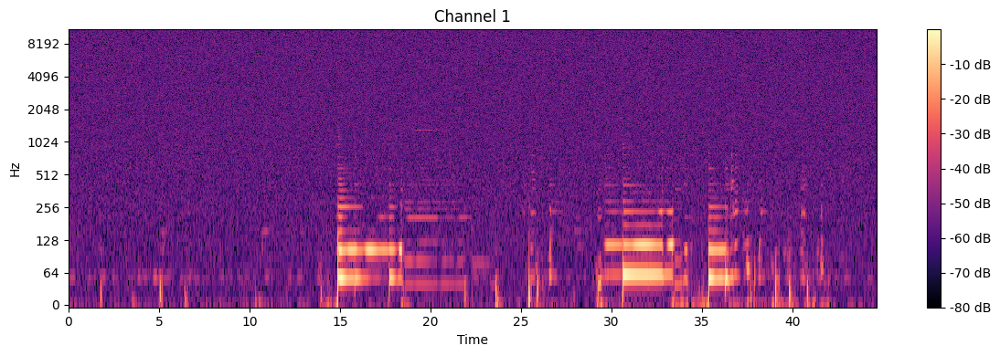

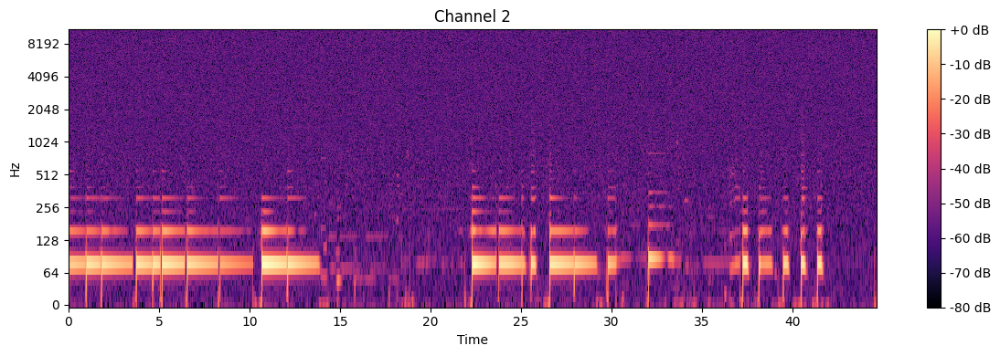

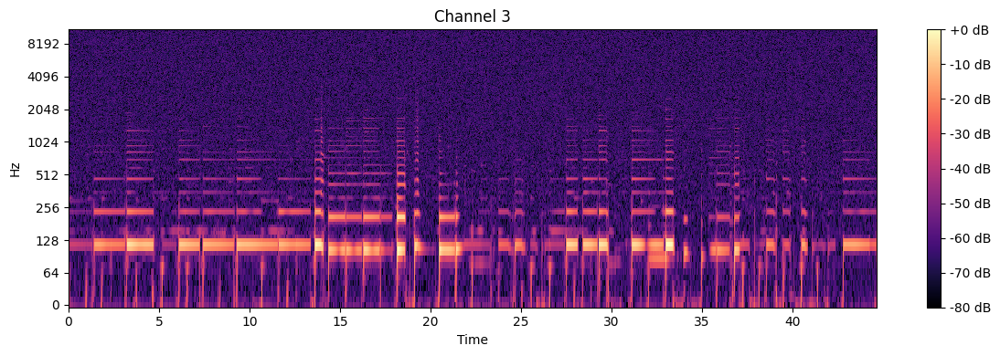

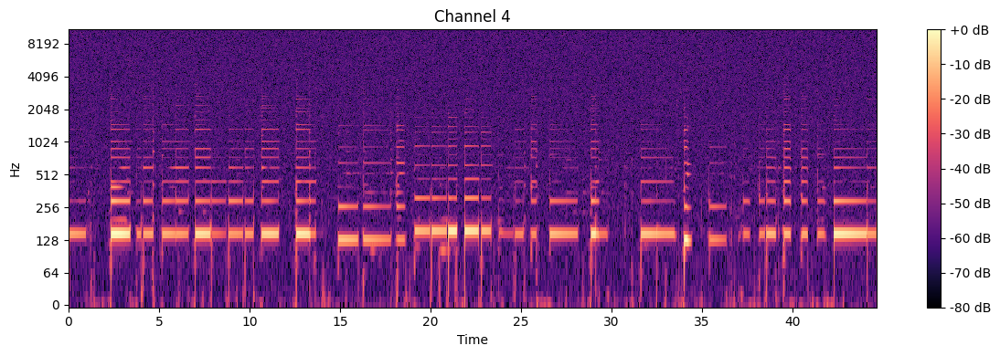

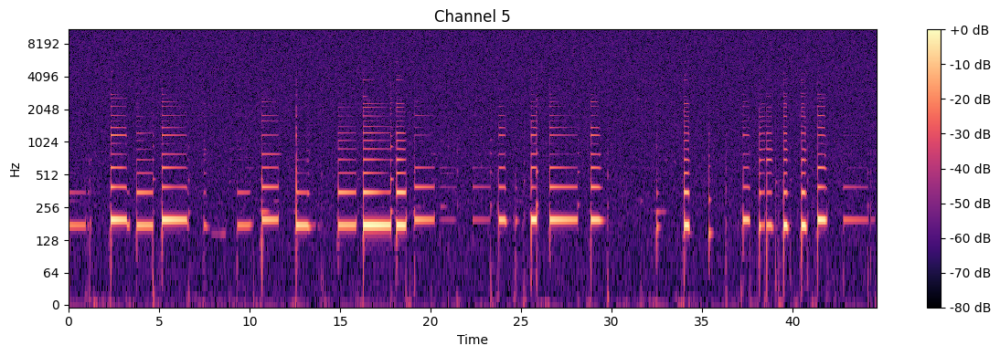

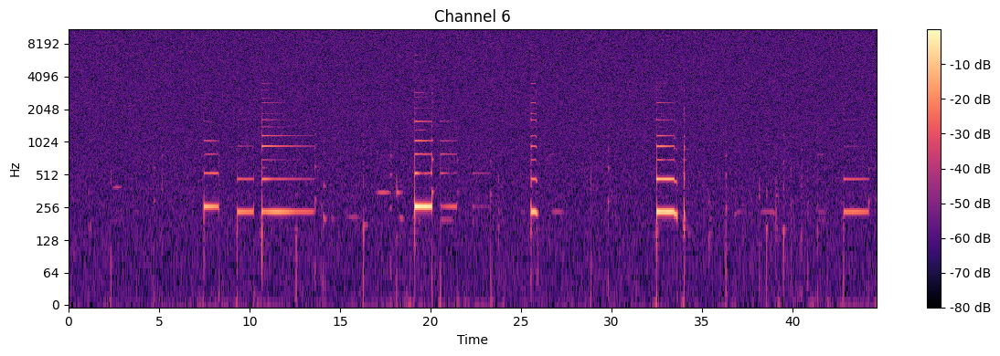

In [ ]:
y, sr = librosa.load('BN1_NI.wav', sr=None, mono=False)
for i in range(y.shape[0]):
    plt.figure(figsize=(12, 4))
    D = librosa.amplitude_to_db(librosa.stft(y[i]), ref=np.max)
    librosa.display.specshow(D, y_axis='log', x_axis='time')
    plt.title(f'Channel {i+1}')
    plt.colorbar(format='%+2.0f dB')
    plt.tight_layout()
    plt.show()

<ipython-input-20-f92f3f92a112>:4: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  D = librosa.amplitude_to_db(librosa.stft(y[i]), ref=np.max)


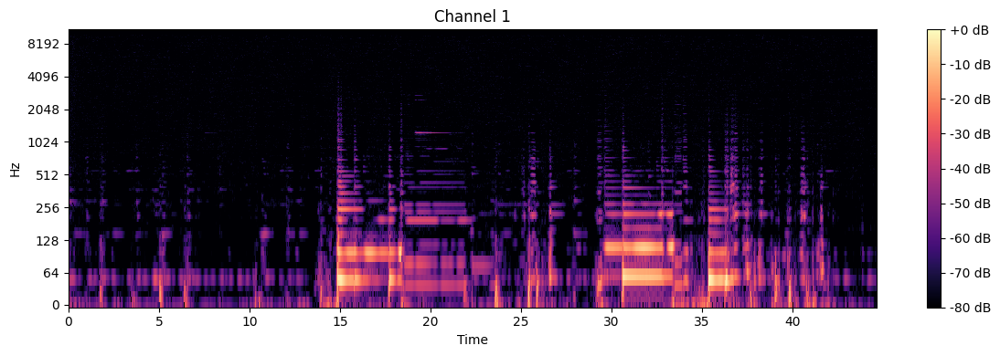

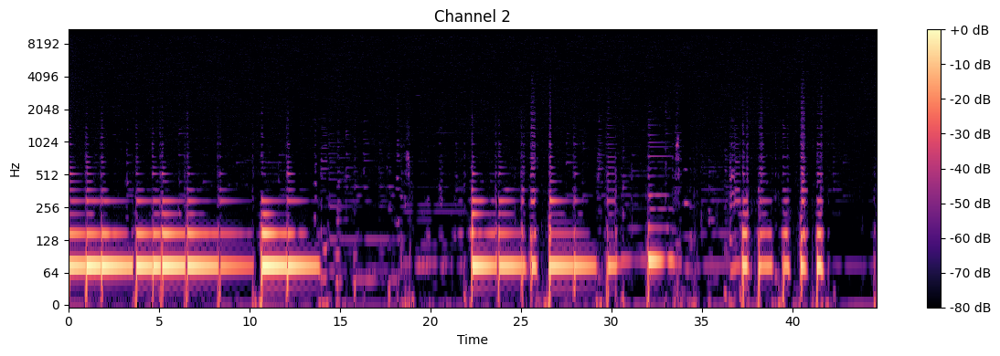

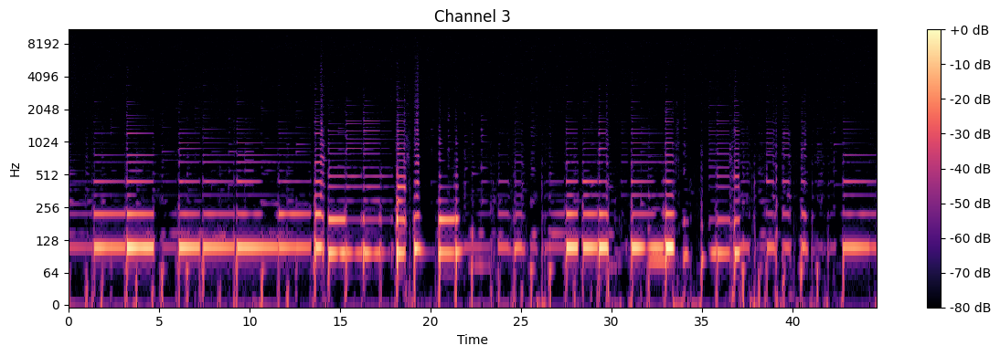

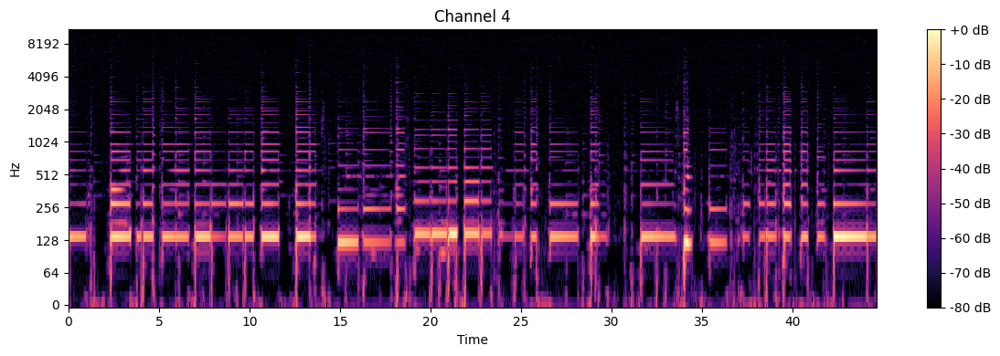

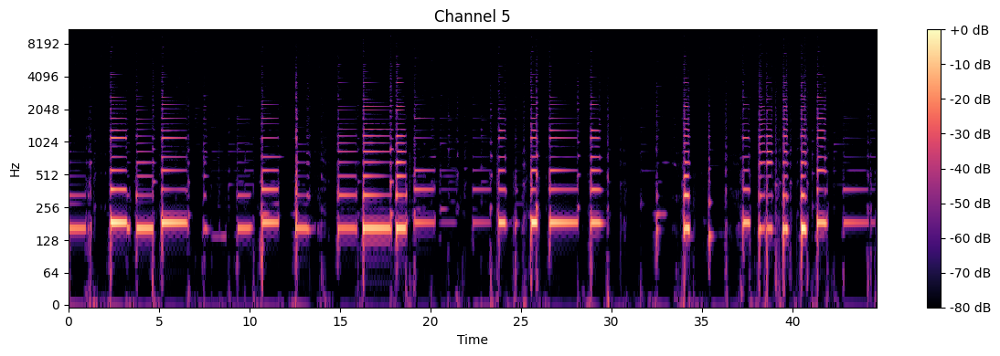

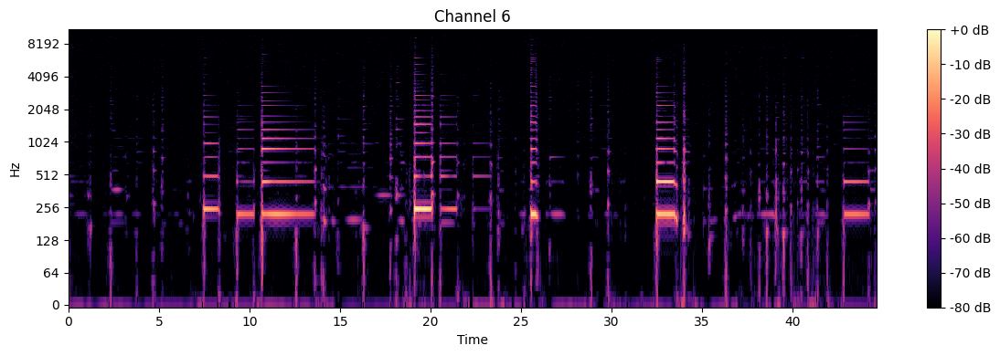

In [ ]:
y, sr = librosa.load('BN1_PS.wav', sr=None, mono=False)
for i in range(y.shape[0]):
    plt.figure(figsize=(12, 4))
    D = librosa.amplitude_to_db(librosa.stft(y[i]), ref=np.max)
    librosa.display.specshow(D, y_axis='log', x_axis='time')
    plt.title(f'Channel {i+1}')
    plt.colorbar(format='%+2.0f dB')
    plt.tight_layout()
    plt.show()

<ipython-input-21-22be62ae8fb9>:4: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  D = librosa.amplitude_to_db(librosa.stft(y[i]), ref=np.max)


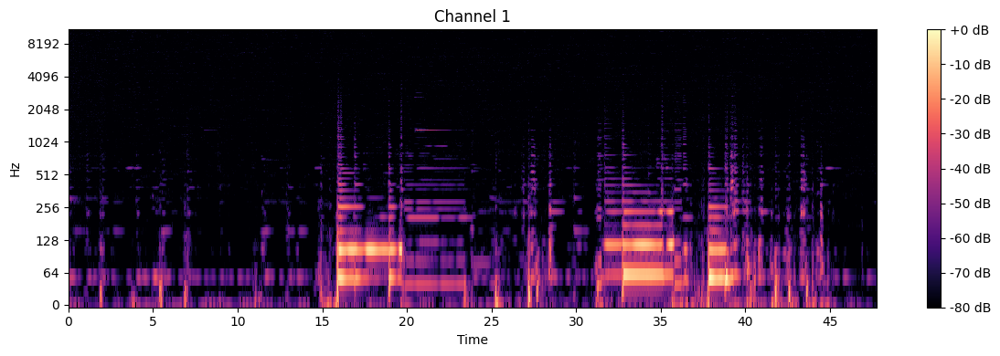

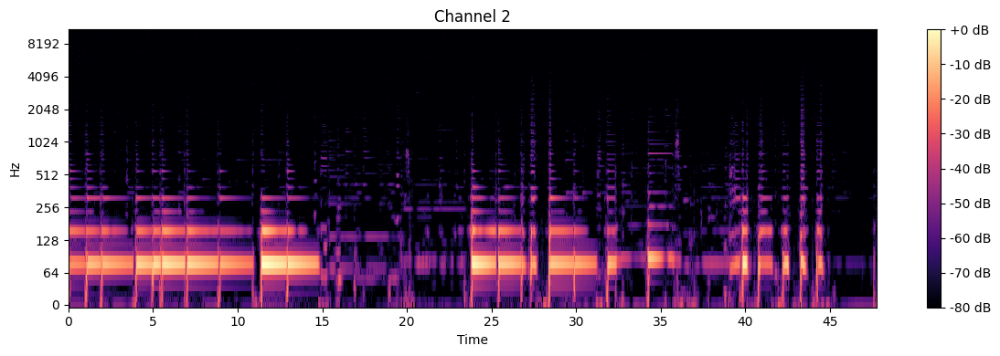

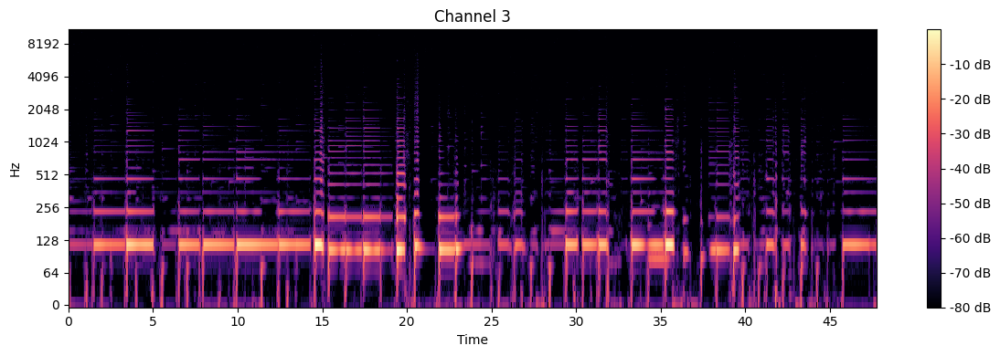

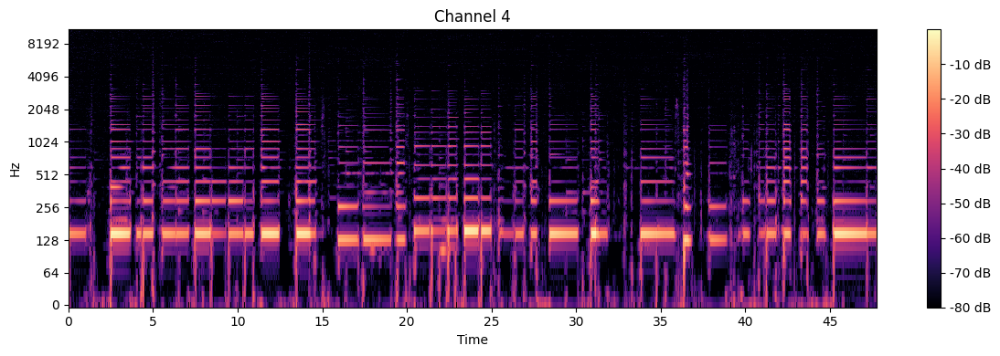

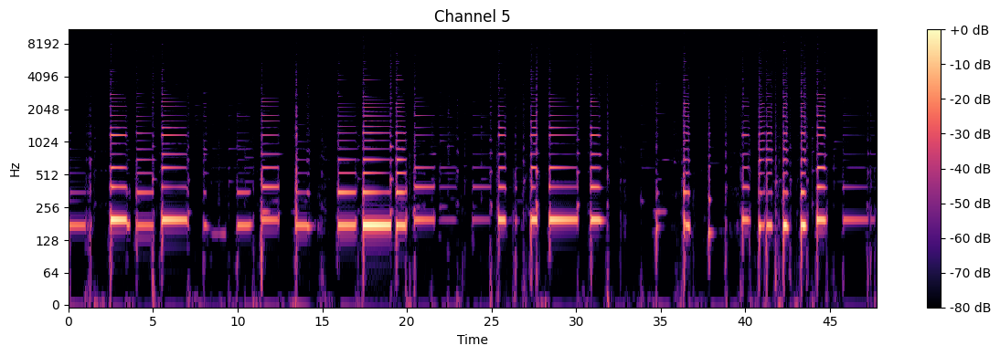

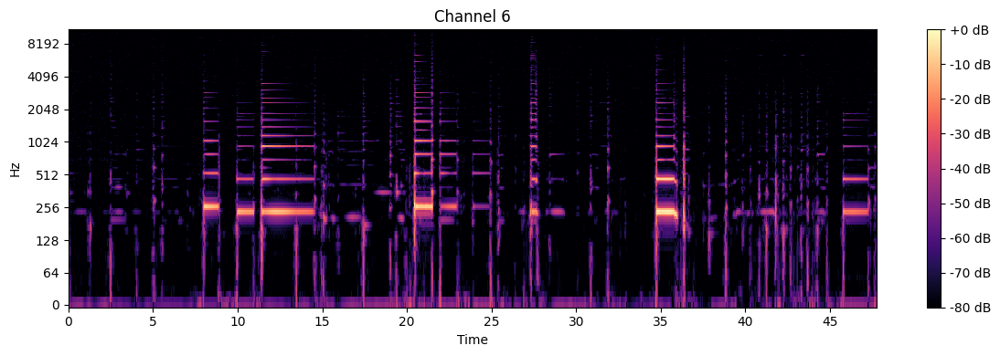

In [ ]:
y, sr = librosa.load('BN1_TS.wav', sr=None, mono=False)
for i in range(y.shape[0]):
    plt.figure(figsize=(12, 4))
    D = librosa.amplitude_to_db(librosa.stft(y[i]), ref=np.max)
    librosa.display.specshow(D, y_axis='log', x_axis='time')
    plt.title(f'Channel {i+1}')
    plt.colorbar(format='%+2.0f dB')
    plt.tight_layout()
    plt.show()

In [ ]:
# Play each channel separately
for i in range(y.shape[0]):
    print(f'Playing channel {i+1}')
    display(Audio(y[i], rate=sr))

Playing channel 1


Playing channel 2


Playing channel 3


Playing channel 4


Playing channel 5


Playing channel 6


In [ ]:
y, sr = librosa.load('00_BN1-129-Eb_comp.wav', sr=None, mono=False)

# Save each channel separately
for i in range(y.shape[0]):
    sf.write(f'channel_{i+1}.wav', y[i], sr)